In [1]:
import pandas as pd
import numpy as np
import os
import matplotlib.pyplot as plt
import seaborn as sns

np.random.seed(42)
%matplotlib inline

# Importing Data

In [2]:
data_folder_name='Data'
file_names=os.listdir('Data')

In [3]:
print(file_names)

['RUL_FD001.txt', 'RUL_FD002.txt', 'RUL_FD003.txt', 'RUL_FD004.txt', 'test_FD001.txt', 'test_FD002.txt', 'test_FD003.txt', 'test_FD004.txt', 'train_FD001.txt', 'train_FD002.txt', 'train_FD003.txt', 'train_FD004.txt']


In [4]:
df_train=pd.read_csv('Data/train_FD001.txt',sep=' ',header=None)
x_valid=pd.read_csv('Data/test_FD001.txt',sep=' ',header=None)
y_valid=pd.read_csv('Data/RUL_FD001.txt',sep=' ',header=None)

In [5]:
x_valid.shape

(13096, 28)

In [6]:
y_valid.shape

(100, 2)

#### Renaming columns

In [7]:
index_names = ['Engine', 'Cycle']
setting_names = ['Setting 1', 'Setting 2', 'Setting 3']
sensor_names=[ 
"(Fan Inlet Temperature) (◦R)",
"(LPC Outlet Temperature) (◦R)",
"(HPC Outlet Temperature) (◦R)",
"(LPT Outlet Temperature) (◦R)",
"(Fan Inlet Pressure) (psia)",
"(Bypass-Duct Pressure) (psia)",
"(HPC Outlet Pressure) (psia)",
"(Physical Fan Speed) (rpm)",
"(Physical Core Speed) (rpm)",
"(Engine Pressure Ratio(P50/P2)",
"(HPC Outlet Static Pressure) (psia)",
"(Ratio of Fuel Flow to Ps30) (pps/psia)",
"(Corrected Fan Speed) (rpm)",
"(Corrected Core Speed) (rpm)",
"(Bypass Ratio) ",
"(Burner Fuel-Air Ratio)",
"(Bleed Enthalpy)",
"(Demanded Fan Speed) (rpm)",
"(Demanded Corrected Fan Speed) (rpm)",
"(HPT Coolant Bleed) (lbm/s)",
"(Low-Pressure Turbines Cool Air Flow) (lbm/s)",
"Sensor 26",
"Sensor 27"]
col_names = index_names + setting_names + sensor_names

In [8]:
df_train.columns=col_names
df_train.drop(columns=['Sensor 26','Sensor 27'],inplace=True)

x_valid.columns=col_names
x_valid.drop(columns=['Sensor 26','Sensor 27'],inplace=True)

y_valid.drop(columns=[1],inplace=True)
y_valid.columns=['RUL']

In [9]:
df_train.head()

,Engine,Cycle,Setting 1,Setting 2,Setting 3,(Fan Inlet Temperature) (◦R),(LPC Outlet Temperature) (◦R),(HPC Outlet Temperature) (◦R),(LPT Outlet Temperature) (◦R),(Fan Inlet Pressure) (psia),...,(Ratio of Fuel Flow to Ps30) (pps/psia),(Corrected Fan Speed) (rpm),(Corrected Core Speed) (rpm),(Bypass Ratio),(Burner Fuel-Air Ratio),(Bleed Enthalpy),(Demanded Fan Speed) (rpm),(Demanded Corrected Fan Speed) (rpm),(HPT Coolant Bleed) (lbm/s),(Low-Pressure Turbines Cool Air Flow) (lbm/s)
0,1,1,-0.0007,-0.0004,100.0,518.67,641.82,1589.70,1400.60,14.62,...,521.66,2388.02,8138.62,8.4195,0.03,392,2388,100.0,39.06,23.4190
1,1,2,0.0019,-0.0003,100.0,518.67,642.15,1591.82,1403.14,14.62,...,522.28,2388.07,8131.49,8.4318,0.03,392,2388,100.0,39.00,23.4236
2,1,3,-0.0043,0.0003,100.0,518.67,642.35,1587.99,1404.20,14.62,...,522.42,2388.03,8133.23,8.4178,0.03,390,2388,100.0,38.95,23.3442
3,1,4,0.0007,0.0000,100.0,518.67,642.35,1582.79,1401.87,14.62,...,522.86,2388.08,8133.83,8.3682,0.03,392,2388,100.0,38.88,23.3739
4,1,5,-0.0019,-0.0002,100.0,518.67,642.37,1582.85,1406.22,14.62,...,522.19,2388.04,8133.80,8.4294,0.03,393,2388,100.0,38.90,23.4044


In [10]:
x_valid.head()

,Engine,Cycle,Setting 1,Setting 2,Setting 3,(Fan Inlet Temperature) (◦R),(LPC Outlet Temperature) (◦R),(HPC Outlet Temperature) (◦R),(LPT Outlet Temperature) (◦R),(Fan Inlet Pressure) (psia),...,(Ratio of Fuel Flow to Ps30) (pps/psia),(Corrected Fan Speed) (rpm),(Corrected Core Speed) (rpm),(Bypass Ratio),(Burner Fuel-Air Ratio),(Bleed Enthalpy),(Demanded Fan Speed) (rpm),(Demanded Corrected Fan Speed) (rpm),(HPT Coolant Bleed) (lbm/s),(Low-Pressure Turbines Cool Air Flow) (lbm/s)
0,1,1,0.0023,0.0003,100.0,518.67,643.02,1585.29,1398.21,14.62,...,521.72,2388.03,8125.55,8.4052,0.03,392,2388,100.0,38.86,23.3735
1,1,2,-0.0027,-0.0003,100.0,518.67,641.71,1588.45,1395.42,14.62,...,522.16,2388.06,8139.62,8.3803,0.03,393,2388,100.0,39.02,23.3916
2,1,3,0.0003,0.0001,100.0,518.67,642.46,1586.94,1401.34,14.62,...,521.97,2388.03,8130.10,8.4441,0.03,393,2388,100.0,39.08,23.4166
3,1,4,0.0042,0.0000,100.0,518.67,642.44,1584.12,1406.42,14.62,...,521.38,2388.05,8132.90,8.3917,0.03,391,2388,100.0,39.00,23.3737
4,1,5,0.0014,0.0000,100.0,518.67,642.51,1587.19,1401.92,14.62,...,522.15,2388.03,8129.54,8.4031,0.03,390,2388,100.0,38.99,23.4130


In [11]:
y_valid.head()

,RUL
0,112
1,98
2,69
3,82
4,91


# Exploration

In [12]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20631 entries, 0 to 20630
Data columns (total 26 columns):
 #   Column                                         Non-Null Count  Dtype  
---  ------                                         --------------  -----  
 0   Engine                                         20631 non-null  int64  
 1   Cycle                                          20631 non-null  int64  
 2   Setting 1                                      20631 non-null  float64
 3   Setting 2                                      20631 non-null  float64
 4   Setting 3                                      20631 non-null  float64
 5   (Fan Inlet Temperature) (◦R)                   20631 non-null  float64
 6   (LPC Outlet Temperature) (◦R)                  20631 non-null  float64
 7   (HPC Outlet Temperature) (◦R)                  20631 non-null  float64
 8   (LPT Outlet Temperature) (◦R)                  20631 non-null  float64
 9   (Fan Inlet Pressure) (psia)                    206

In [13]:
df_train.describe().T

,count,mean,std,min,25%,50%,75%,max
Engine,20631.0,51.506568,2.922763e+01,1.0000,26.0000,52.0000,77.0000,100.0000
Cycle,20631.0,108.807862,6.888099e+01,1.0000,52.0000,104.0000,156.0000,362.0000
Setting 1,20631.0,-0.000009,2.187313e-03,-0.0087,-0.0015,0.0000,0.0015,0.0087
Setting 2,20631.0,0.000002,2.930621e-04,-0.0006,-0.0002,0.0000,0.0003,0.0006
Setting 3,20631.0,100.000000,0.000000e+00,100.0000,100.0000,100.0000,100.0000,100.0000
(Fan Inlet Temperature) (◦R),20631.0,518.670000,6.537152e-11,518.6700,518.6700,518.6700,518.6700,518.6700
(LPC Outlet Temperature) (◦R),20631.0,642.680934,5.000533e-01,641.2100,642.3250,642.6400,643.0000,644.5300
(HPC Outlet Temperature) (◦R),20631.0,1590.523119,6.131150e+00,1571.0400,1586.2600,1590.1000,1594.3800,1616.9100
(LPT Outlet Temperature) (◦R),20631.0,1408.933782,9.000605e+00,1382.2500,1402.3600,1408.0400,1414.5550,1441.4900
(Fan Inlet Pressure) (psia),20631.0,14.620000,3.394700e-12,14.6200,14.6200,14.6200,14.6200,14.6200


In [14]:
print(f"None values in test, and y data sets: {x_valid.isna().sum().sum()}, {y_valid.isna().sum().sum()}")

None values in test, and y data sets: 0, 0


In [15]:
import ydata_profiling

from ydata_profiling import ProfileReport

In [16]:
%%time
profile = ProfileReport(df_train,
                        title="Predictive Maintenance",
                        dataset={"description": "Set1",
                                 "copyright_holder": "Jan Toczko",
                                 "copyright_year": "2024",
                                },
                        explorative=True,
                       )
profile

CPU times: total: 0 ns
Wall time: 3.01 ms


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Removing columns with constant values

In [17]:
df_train_backup=df_train

In [18]:
constant_columns=[]
for column in df_train.columns:
    if df_train[column].max()==df_train[column].min():
        constant_columns.append(column)

print(constant_columns)

['Setting 3', '(Fan Inlet Temperature) (◦R)', '(Fan Inlet Pressure) (psia)', '(Engine Pressure Ratio(P50/P2)', '(Burner Fuel-Air Ratio)', '(Demanded Fan Speed) (rpm)', '(Demanded Corrected Fan Speed) (rpm)']


In [19]:
df_train.drop(columns=constant_columns, inplace=True)

In [20]:
df_train.head()

,Engine,Cycle,Setting 1,Setting 2,(LPC Outlet Temperature) (◦R),(HPC Outlet Temperature) (◦R),(LPT Outlet Temperature) (◦R),(Bypass-Duct Pressure) (psia),(HPC Outlet Pressure) (psia),(Physical Fan Speed) (rpm),(Physical Core Speed) (rpm),(HPC Outlet Static Pressure) (psia),(Ratio of Fuel Flow to Ps30) (pps/psia),(Corrected Fan Speed) (rpm),(Corrected Core Speed) (rpm),(Bypass Ratio),(Bleed Enthalpy),(HPT Coolant Bleed) (lbm/s),(Low-Pressure Turbines Cool Air Flow) (lbm/s)
0,1,1,-0.0007,-0.0004,641.82,1589.70,1400.60,21.61,554.36,2388.06,9046.19,47.47,521.66,2388.02,8138.62,8.4195,392,39.06,23.4190
1,1,2,0.0019,-0.0003,642.15,1591.82,1403.14,21.61,553.75,2388.04,9044.07,47.49,522.28,2388.07,8131.49,8.4318,392,39.00,23.4236
2,1,3,-0.0043,0.0003,642.35,1587.99,1404.20,21.61,554.26,2388.08,9052.94,47.27,522.42,2388.03,8133.23,8.4178,390,38.95,23.3442
3,1,4,0.0007,0.0000,642.35,1582.79,1401.87,21.61,554.45,2388.11,9049.48,47.13,522.86,2388.08,8133.83,8.3682,392,38.88,23.3739
4,1,5,-0.0019,-0.0002,642.37,1582.85,1406.22,21.61,554.00,2388.06,9055.15,47.28,522.19,2388.04,8133.80,8.4294,393,38.90,23.4044


## Correlations

In [21]:
df_corr=df_train.corr().abs()

In [22]:
df_corr.head()

,Engine,Cycle,Setting 1,Setting 2,(LPC Outlet Temperature) (◦R),(HPC Outlet Temperature) (◦R),(LPT Outlet Temperature) (◦R),(Bypass-Duct Pressure) (psia),(HPC Outlet Pressure) (psia),(Physical Fan Speed) (rpm),(Physical Core Speed) (rpm),(HPC Outlet Static Pressure) (psia),(Ratio of Fuel Flow to Ps30) (pps/psia),(Corrected Fan Speed) (rpm),(Corrected Core Speed) (rpm),(Bypass Ratio),(Bleed Enthalpy),(HPT Coolant Bleed) (lbm/s),(Low-Pressure Turbines Cool Air Flow) (lbm/s)
Engine,1.000000,0.078753,0.017895,0.006197,0.014133,0.012621,0.026116,0.026431,0.032073,0.039929,0.052053,0.024707,0.031882,0.044230,0.059473,0.022486,0.013513,0.020589,0.016465
Cycle,0.078753,1.000000,0.004527,0.016132,0.549898,0.543947,0.624577,0.105980,0.595914,0.475977,0.443999,0.634385,0.611354,0.477523,0.370324,0.588676,0.566995,0.583597,0.585923
Setting 1,0.017895,0.004527,1.000000,0.011660,0.009030,0.005651,0.009544,0.001340,0.009437,0.000427,0.004279,0.011658,0.001491,0.002318,0.004469,0.007652,0.002599,0.005713,0.014559
Setting 2,0.006197,0.016132,0.011660,1.000000,0.007266,0.009068,0.014673,0.014355,0.016678,0.013285,0.005425,0.011690,0.010923,0.018156,0.006310,0.014156,0.012280,0.010554,0.007846
(LPC Outlet Temperature) (◦R),0.014133,0.549898,0.009030,0.007266,1.000000,0.602610,0.714949,0.132242,0.702136,0.662325,0.273764,0.740020,0.724578,0.661792,0.179752,0.675975,0.629886,0.661841,0.668050


In [23]:
threshold=0.9
mask=df_corr.where(df_corr>=threshold).isna()

In [24]:
mask

,Engine,Cycle,Setting 1,Setting 2,(LPC Outlet Temperature) (◦R),(HPC Outlet Temperature) (◦R),(LPT Outlet Temperature) (◦R),(Bypass-Duct Pressure) (psia),(HPC Outlet Pressure) (psia),(Physical Fan Speed) (rpm),(Physical Core Speed) (rpm),(HPC Outlet Static Pressure) (psia),(Ratio of Fuel Flow to Ps30) (pps/psia),(Corrected Fan Speed) (rpm),(Corrected Core Speed) (rpm),(Bypass Ratio),(Bleed Enthalpy),(HPT Coolant Bleed) (lbm/s),(Low-Pressure Turbines Cool Air Flow) (lbm/s)
Engine,False,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True
Cycle,True,False,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True
Setting 1,True,True,False,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True
Setting 2,True,True,True,False,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True
(LPC Outlet Temperature) (◦R),True,True,True,True,False,True,True,True,True,True,True,True,True,True,True,True,True,True,True
(HPC Outlet Temperature) (◦R),True,True,True,True,True,False,True,True,True,True,True,True,True,True,True,True,True,True,True
(LPT Outlet Temperature) (◦R),True,True,True,True,True,True,False,True,True,True,True,True,True,True,True,True,True,True,True
(Bypass-Duct Pressure) (psia),True,True,True,True,True,True,True,False,True,True,True,True,True,True,True,True,True,True,True
(HPC Outlet Pressure) (psia),True,True,True,True,True,True,True,True,False,True,True,True,True,True,True,True,True,True,True
(Physical Fan Speed) (rpm),True,True,True,True,True,True,True,True,True,False,True,True,True,True,True,True,True,True,True


In [25]:
sns.set_style("whitegrid")

<AxesSubplot: >

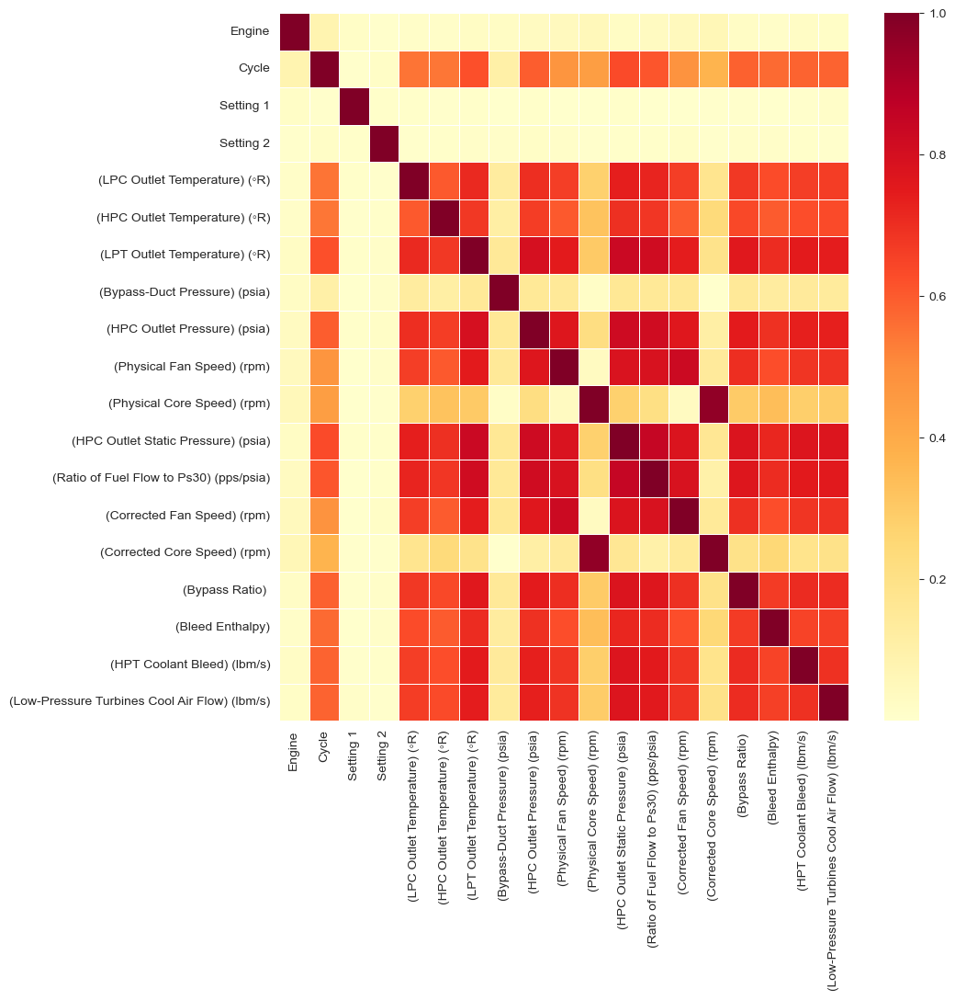

In [26]:
plt.figure(figsize=(10,10))
sns.heatmap(df_corr, cmap="YlOrRd", linewidths=0.6, linecolor='White')

<AxesSubplot: >

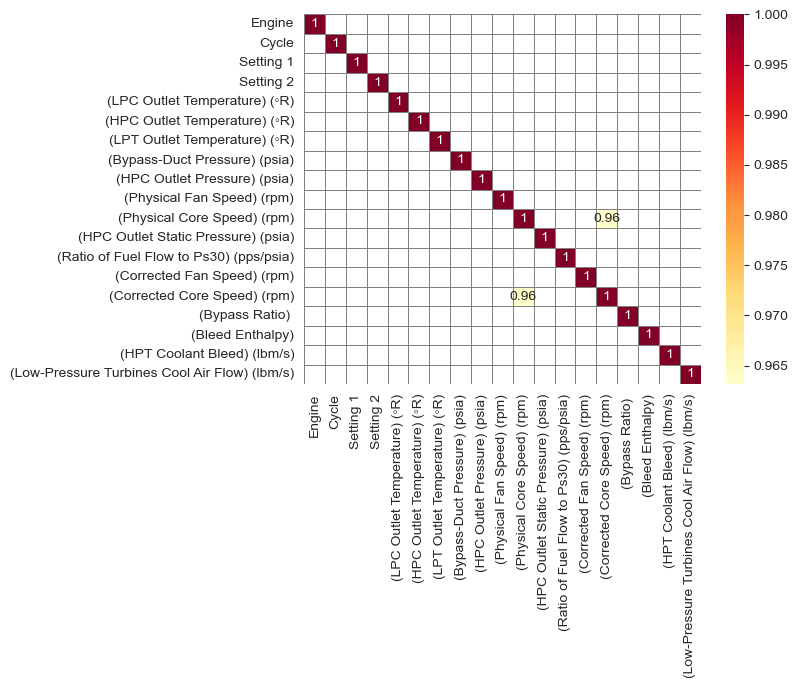

In [27]:
#plt.figure(figsize=(10,10))
sns.heatmap(df_corr, cmap="YlOrRd", linewidths=0.6, linecolor='Gray', annot=True, mask=mask)

In [28]:
upper_triangle = df_corr.where(np.triu(np.ones(df_corr.shape), k=1).astype(bool))

high_corr_columns=[]
for column in upper_triangle.columns:
    if upper_triangle[column].max()>threshold:
        high_corr_columns.append(column)
        
print(high_corr_columns)

['(Corrected Core Speed) (rpm)']


In [29]:
df_train.drop(columns=high_corr_columns, inplace=True)

#### Useful columns

In [30]:
df_train.columns

Index(['Engine', 'Cycle', 'Setting 1', 'Setting 2',
       '(LPC Outlet Temperature) (◦R)', '(HPC Outlet Temperature) (◦R)',
       '(LPT Outlet Temperature) (◦R)', '(Bypass-Duct Pressure) (psia)',
       '(HPC Outlet Pressure) (psia)', '(Physical Fan Speed) (rpm)',
       '(Physical Core Speed) (rpm)', '(HPC Outlet Static Pressure) (psia)',
       '(Ratio of Fuel Flow to Ps30) (pps/psia)',
       '(Corrected Fan Speed) (rpm)', '(Bypass Ratio) ', '(Bleed Enthalpy)',
       '(HPT Coolant Bleed) (lbm/s)',
       '(Low-Pressure Turbines Cool Air Flow) (lbm/s)'],
      dtype='object')

## Adding engine life and remaining useful life columns 

In [31]:
df_train_backup2=df_train

In [32]:
#add_life_RUL(df_train_backup2)

In [33]:
Life=df_train.groupby('Engine')['Cycle'].max()

df_train=df_train.merge(Life, how='left', on='Engine')

df_train.rename(columns={"Cycle_y":"Life","Cycle_x":'Cycle'},inplace=True)


df_train['RUL']=df_train['Life']-df_train['Cycle']

In [34]:
df_train.iloc[185:195]

,Engine,Cycle,Setting 1,Setting 2,(LPC Outlet Temperature) (◦R),(HPC Outlet Temperature) (◦R),(LPT Outlet Temperature) (◦R),(Bypass-Duct Pressure) (psia),(HPC Outlet Pressure) (psia),(Physical Fan Speed) (rpm),(Physical Core Speed) (rpm),(HPC Outlet Static Pressure) (psia),(Ratio of Fuel Flow to Ps30) (pps/psia),(Corrected Fan Speed) (rpm),(Bypass Ratio),(Bleed Enthalpy),(HPT Coolant Bleed) (lbm/s),(Low-Pressure Turbines Cool Air Flow) (lbm/s),Life,RUL
185,1,186,0.0027,-0.0003,643.51,1595.16,1426.30,21.61,552.57,2388.21,9051.37,48.12,520.08,2388.25,8.5227,397,38.47,23.0564,192,6
186,1,187,-0.0047,-0.0000,643.32,1592.10,1427.27,21.61,551.08,2388.29,9037.71,48.23,519.53,2388.28,8.5218,396,38.42,23.0822,192,5
187,1,188,-0.0067,0.0003,643.75,1602.38,1422.78,21.61,551.94,2388.31,9037.91,48.00,519.79,2388.23,8.5207,396,38.51,22.9588,192,4
188,1,189,-0.0006,0.0002,644.18,1596.17,1428.01,21.61,550.70,2388.27,9044.55,48.08,519.58,2388.33,8.5183,395,38.48,23.1127,192,3
189,1,190,-0.0027,0.0001,643.64,1599.22,1425.95,21.61,551.29,2388.29,9040.58,48.33,520.04,2388.35,8.5223,398,38.49,23.0675,192,2
190,1,191,-0.0000,-0.0004,643.34,1602.36,1425.77,21.61,550.92,2388.28,9042.76,48.15,519.57,2388.30,8.5174,394,38.45,23.1295,192,1
191,1,192,0.0009,-0.0000,643.54,1601.41,1427.20,21.61,551.25,2388.32,9033.22,48.25,520.08,2388.32,8.5113,396,38.48,22.9649,192,0
192,2,1,-0.0018,0.0006,641.89,1583.84,1391.28,21.60,554.53,2388.01,9054.72,46.93,522.33,2388.06,8.3905,391,38.94,23.4585,287,286
193,2,2,0.0043,-0.0003,641.82,1587.05,1393.13,21.61,554.77,2387.98,9051.31,47.24,522.70,2387.98,8.4167,392,39.06,23.4085,287,285
194,2,3,0.0018,0.0003,641.55,1588.32,1398.96,21.60,555.14,2388.04,9054.24,47.22,522.58,2387.99,8.3802,391,39.11,23.4250,287,284


Text(0.5, 1.0, 'Total Life')

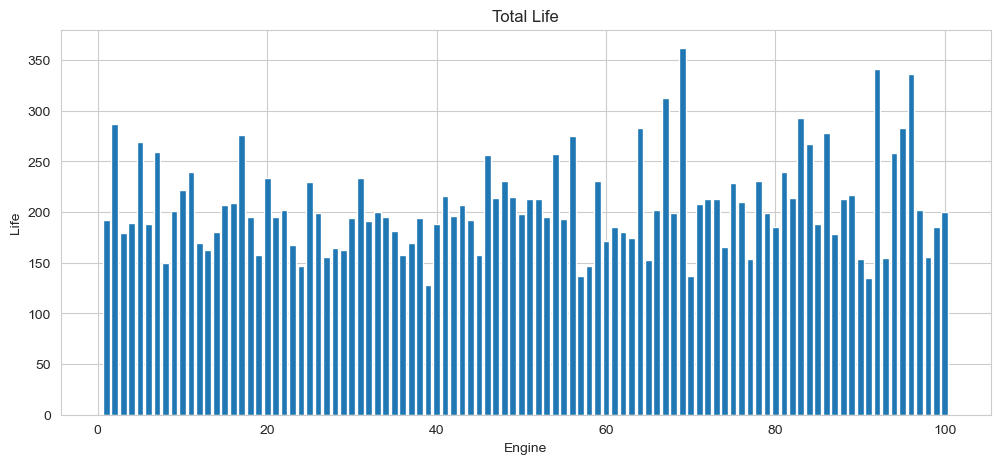

In [35]:
plt.figure(figsize=(12,5))
plt.bar(x=Life.index,height=Life)
plt.xlabel('Engine')
plt.ylabel('Life')
plt.title('Total Life')

# Sensor plots

In [36]:
engines=df_train['Engine'].unique()
sensors=df_train.columns[2:-2]

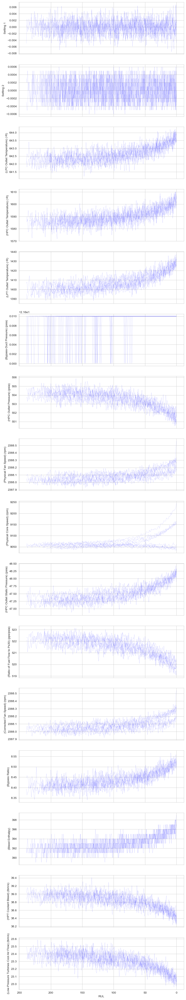

In [37]:
fig, ax=plt.subplots(nrows=len(df_train.columns[2:-2]), ncols=1, figsize=(10,60), sharex=True)
ax[0].invert_xaxis()


sensor=sensors[3]
for i, sensor in enumerate(sensors):
    for engine in engines[::10]:
        df_plot=df_train[df_train['Engine']==engine][[sensor,'RUL']]
        
        sensor_plot=sns.lineplot(data=df_plot, x=df_plot['RUL'], y=df_plot[sensor], linewidth=0.1, color='blue', ax=ax[i])
    

# Correlations with RUL

In [38]:
RUL_sensor_corr = {}
for sensor in df_train.columns[:-2]:
    RUL_sensor_corr.update({sensor : df_train[sensor].corr(df_train['RUL'])}) 
#RUL_sensor_corr

RUL_sensor_corr = abs(pd.DataFrame.from_dict(RUL_sensor_corr , orient='index' , columns=['correlation with RUL']))

RUL_sensor_corr.sort_values(by='correlation with RUL', inplace=True)
RUL_sensor_corr

,correlation with RUL
Setting 2,0.001948
Setting 1,0.003198
Engine,0.078753
(Bypass-Duct Pressure) (psia),0.128348
(Physical Core Speed) (rpm),0.390102
(Corrected Fan Speed) (rpm),0.562569
(Physical Fan Speed) (rpm),0.563968
(HPC Outlet Temperature) (◦R),0.584520
(Bleed Enthalpy),0.606154
(LPC Outlet Temperature) (◦R),0.606484


Setting 2 and Setting 1 have a very weak correlation with RUL so they migth be dropped, also bypass duct pressure migth be dropped, as it has weak correlation and only 2 very similar values

### Splitting data

In [39]:
def rename_to_feature(df): #replaces names in train/test data frames feature_i...
    nice_names=[]
    for i, column in enumerate(df.columns):
        nice_names.append(f'feature_{i+1}')

    df.columns=nice_names

In [40]:
from sklearn.model_selection import train_test_split

In [41]:
X=df_train[df_train.columns[0:-2]]
Y=df_train["RUL"]

In [42]:
rename_to_feature(X)
X

,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,feature_8,feature_9,feature_10,feature_11,feature_12,feature_13,feature_14,feature_15,feature_16,feature_17,feature_18
0,1,1,-0.0007,-0.0004,641.82,1589.70,1400.60,21.61,554.36,2388.06,9046.19,47.47,521.66,2388.02,8.4195,392,39.06,23.4190
1,1,2,0.0019,-0.0003,642.15,1591.82,1403.14,21.61,553.75,2388.04,9044.07,47.49,522.28,2388.07,8.4318,392,39.00,23.4236
2,1,3,-0.0043,0.0003,642.35,1587.99,1404.20,21.61,554.26,2388.08,9052.94,47.27,522.42,2388.03,8.4178,390,38.95,23.3442
3,1,4,0.0007,0.0000,642.35,1582.79,1401.87,21.61,554.45,2388.11,9049.48,47.13,522.86,2388.08,8.3682,392,38.88,23.3739
4,1,5,-0.0019,-0.0002,642.37,1582.85,1406.22,21.61,554.00,2388.06,9055.15,47.28,522.19,2388.04,8.4294,393,38.90,23.4044
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20626,100,196,-0.0004,-0.0003,643.49,1597.98,1428.63,21.61,551.43,2388.19,9065.52,48.07,519.49,2388.26,8.4956,397,38.49,22.9735
20627,100,197,-0.0016,-0.0005,643.54,1604.50,1433.58,21.61,550.86,2388.23,9065.11,48.04,519.68,2388.22,8.5139,395,38.30,23.1594
20628,100,198,0.0004,0.0000,643.42,1602.46,1428.18,21.61,550.94,2388.24,9065.90,48.09,520.01,2388.24,8.5646,398,38.44,22.9333
20629,100,199,-0.0011,0.0003,643.23,1605.26,1426.53,21.61,550.68,2388.25,9073.72,48.39,519.67,2388.23,8.5389,395,38.29,23.0640


In [43]:
train_x, test_x, train_y, test_y=train_test_split(X, Y, random_state=0)

In [44]:
train_y.head()

5449      15
19357    194
3429     151
11153    101
18342     37
Name: RUL, dtype: int64

# Scoring functions

In [45]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import mean_absolute_error 
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import cross_validate
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error

In [46]:
scoring=['r2','neg_mean_absolute_error','neg_mean_squared_error']

In [47]:
# Returns dictionary with R2, negative mean absolute error and negative mean squared error
def results(test_y, pred_y):
    scores = {'r2':r2_score(test_y, pred_y), 'mae' : -mean_absolute_error(test_y, pred_y), 'mse':-mean_squared_error(test_y, pred_y)}
    
    print(f'R2 = {scores["r2"]}; Mean Absolute Error = {scores["mae"]}; Mean Squared Error = {scores["mse"]}')
    return scores

In [48]:
# Performs cross valuation and returns data frame with R2, 
# negative mean absolute error and negative mean squared error for each split
def cross_val(method, X, Y, splits):
    cv_full=cross_validate(method, X, Y, cv=splits, scoring=scoring, return_estimator=True)

    #getting cross valuation results into a data frame 
    keys=list(cv_full.keys())

    df_cv_results=pd.DataFrame()

    for key in keys: 
        df_cv_results[key]=cv_full[key]

    return df_cv_results

    

In [49]:
def combine_test_predictions(test_y, pred_y): #combines test_y series and pred array into a data frame
    
    df_testpred = pd.DataFrame({'real_RUL':test_y.values, 'predicted_RUL':pred_y} , index=test_x_d.index)
    return df_testpred

In [50]:
def accuracy_plot(x_test, y_test, y_pred):
    fig,ax = plt.subplots()
    scatter = sns.scatterplot(x = y_test, y=y_pred )
    centerline = sns.lineplot(x=[min(y_test),max(y_test)], y=[min(y_test),max(y_test)])
    plt.xlabel('real RUL')
    plt.ylabel('predicted RUL')
    

In [51]:
def real_predicted_plot(test_y, pred_y):
    plt.figure(figsize=(12,6))
    plt.title("Real RUL and Predicted RUL")

    plot=sns.barplot(x=list(range(1,len(test_y)+1)), y=test_y, color='black', width=0.3, label='real RUL')

    plot=sns.barplot(x=list(range(1,len(pred_y)+1)), y=pred_y, color='blue', width=0.7, alpha=0.6, label='predicted RUL')

    plot.legend(title ='RUL')

## Scaling data

In [52]:
'''
Normalazing X does not seem to impact the accuracy of the models

from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()

train_x_scaled = scaler.fit_transform(train_x)
test_x_scaled = scaler.fit_transform(test_x)

X_scaled = scaler.fit_transform(X)


# train_y and train_y_s as well as test_y and test_y_s are the same
train_x_scaled, test_x_scaled, train_y_s, test_y_s=train_test_split(X, Y, random_state=0)

train_x_scaled
'''

'\nNormalazing X does not seem to impact the accuracy of the models\n\nfrom sklearn.preprocessing import StandardScaler\n\nscaler = StandardScaler()\n\ntrain_x_scaled = scaler.fit_transform(train_x)\ntest_x_scaled = scaler.fit_transform(test_x)\n\nX_scaled = scaler.fit_transform(X)\n\n\n# train_y and train_y_s as well as test_y and test_y_s are the same\ntrain_x_scaled, test_x_scaled, train_y_s, test_y_s=train_test_split(X, Y, random_state=0)\n\ntrain_x_scaled\n'

## Dropping features with low correlation

In [53]:
low_corr_columns = list(RUL_sensor_corr.index[:4]) #dropping setting 1 and 2, Engine, and Bypass duct pressure columns
X_d = df_train[df_train.columns[0:-2]]
X_d.drop(columns=low_corr_columns , axis=1, inplace=True)
Y_d = Y

C:\Users\1xara\AppData\Local\Temp\ipykernel_6840\2494317755.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X_d.drop(columns=low_corr_columns , axis=1, inplace=True)


In [54]:
rename_to_feature(X_d)
X_d

,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,feature_8,feature_9,feature_10,feature_11,feature_12,feature_13,feature_14
0,1,641.82,1589.70,1400.60,554.36,2388.06,9046.19,47.47,521.66,2388.02,8.4195,392,39.06,23.4190
1,2,642.15,1591.82,1403.14,553.75,2388.04,9044.07,47.49,522.28,2388.07,8.4318,392,39.00,23.4236
2,3,642.35,1587.99,1404.20,554.26,2388.08,9052.94,47.27,522.42,2388.03,8.4178,390,38.95,23.3442
3,4,642.35,1582.79,1401.87,554.45,2388.11,9049.48,47.13,522.86,2388.08,8.3682,392,38.88,23.3739
4,5,642.37,1582.85,1406.22,554.00,2388.06,9055.15,47.28,522.19,2388.04,8.4294,393,38.90,23.4044
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20626,196,643.49,1597.98,1428.63,551.43,2388.19,9065.52,48.07,519.49,2388.26,8.4956,397,38.49,22.9735
20627,197,643.54,1604.50,1433.58,550.86,2388.23,9065.11,48.04,519.68,2388.22,8.5139,395,38.30,23.1594
20628,198,643.42,1602.46,1428.18,550.94,2388.24,9065.90,48.09,520.01,2388.24,8.5646,398,38.44,22.9333
20629,199,643.23,1605.26,1426.53,550.68,2388.25,9073.72,48.39,519.67,2388.23,8.5389,395,38.29,23.0640


In [55]:
train_x_d, test_x_d, train_y_d, test_y_d=train_test_split(X_d, Y_d, random_state=0)

## Linear Regression

In [56]:
from sklearn.linear_model import LinearRegression

In [57]:
lr=LinearRegression()
lr.get_params

<bound method BaseEstimator.get_params of LinearRegression()>

In [58]:
lr.fit(train_x, train_y)

LinearRegression()

In [59]:
pred_lr_y=lr.predict(test_x)

In [60]:
lr_results=results(test_y, pred_lr_y)

R2 = 0.6686852485110146; Mean Absolute Error = -30.12142909240609; Mean Squared Error = -1525.6140391529016


In [61]:
lr_cross_val = cross_val(lr, X, Y, 5)

In [62]:
lr_cross_val

,fit_time,score_time,estimator,test_r2,test_neg_mean_absolute_error,test_neg_mean_squared_error
0,0.000000,0.0,LinearRegression(),0.679533,-28.675928,-1411.587704
1,0.008006,0.0,LinearRegression(),0.736304,-23.934461,-849.622168
2,0.008002,0.0,LinearRegression(),0.696508,-27.687724,-1214.070148
3,0.000000,0.0,LinearRegression(),0.551556,-37.237553,-2479.600704
4,0.007999,0.0,LinearRegression(),0.563867,-42.970343,-2699.328200


#### LR on scaled data

In [63]:
"""lr_s=LinearRegression()

lr_s.fit(train_x_scaled, train_y)

pred_lr_y_s = lr_s.predict(test_x_scaled)

lr_s_results = results(test_y, pred_lr_y_s)

# R2 = 0.6686852485110146; Mean Absolute Error = -30.12142909240609; Mean Squared Error = -1525.6140391529016"""

'lr_s=LinearRegression()\n\nlr_s.fit(train_x_scaled, train_y)\n\npred_lr_y_s = lr_s.predict(test_x_scaled)\n\nlr_s_results = results(test_y, pred_lr_y_s)\n\n# R2 = 0.6686852485110146; Mean Absolute Error = -30.12142909240609; Mean Squared Error = -1525.6140391529016'

#### lr with dropped columns

In [64]:
lr_d=LinearRegression()
lr_d.fit(train_x_d, train_y_d)
pred_lr_y_d = lr_d.predict(test_x_d)
lr_d_results = results(test_y_d, pred_lr_y_d)

#R2 = 0.6686116342974429; Mean Absolute Error = -30.124299200972366; Mean Squared Error = -1525.9530125224894

R2 = 0.6541010760985677; Mean Absolute Error = -30.633723781053302; Mean Squared Error = -1592.7701741630722


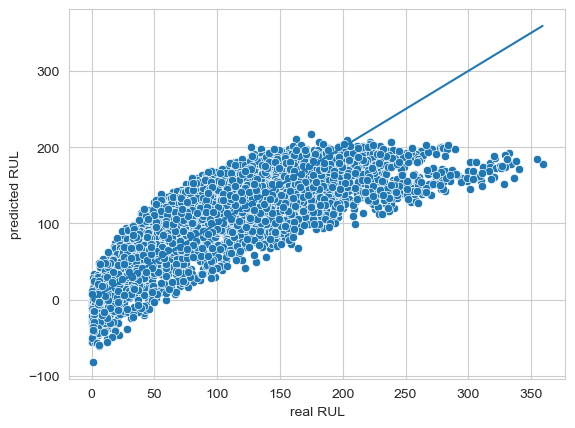

In [65]:
accuracy_plot( test_x_d, test_y_d, pred_lr_y_d)

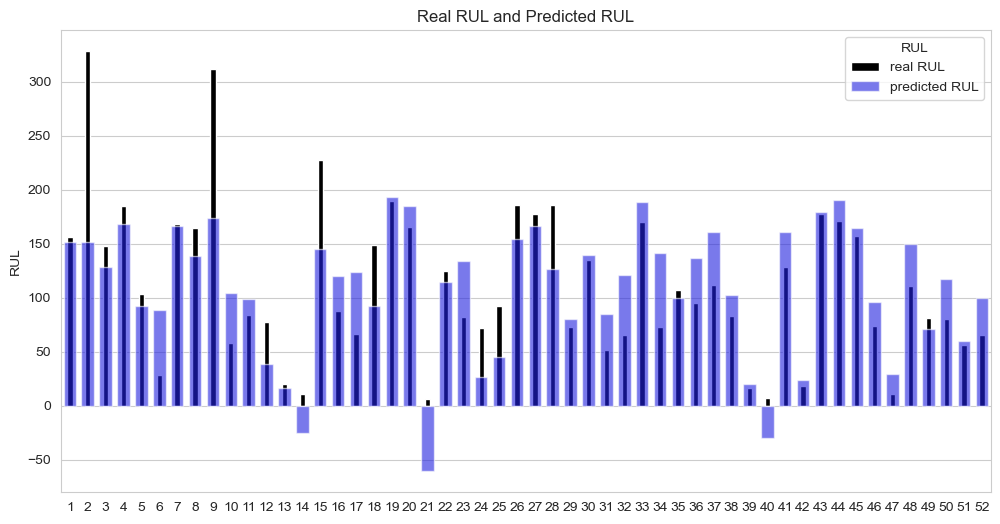

In [66]:
real_predicted_plot(test_y_d[::100], pred_lr_y_d[::100])

In [67]:
np.sort(pred_lr_y_d)

array([-81.75042673, -60.84366149, -59.98403382, ..., 209.77170858,
       210.77598459, 217.32655167])

## Random Forest

In [68]:
from sklearn.ensemble import RandomForestRegressor


In [69]:

'''rfr=RandomForestRegressor()

rfr.fit(train_x, train_y)

pred_rfr_y=rfr.predict(test_x)

rfr_results = results(test_y, pred_rfr_y)'''

'rfr=RandomForestRegressor()\n\nrfr.fit(train_x, train_y)\n\npred_rfr_y=rfr.predict(test_x)\n\nrfr_results = results(test_y, pred_rfr_y)'

#### LR on scaled data

In [70]:
"""rfr_s = RandomForestRegressor()

rfr_s.fit(train_x_scaled, train_y)

pred_rfr_y_s = rfr_s.predict(test_x_scaled)

rfr_s_results = results(test_y, pred_rfr_y_s)

# R2 = 0.9392719147956299; Mean Absolute Error = -11.662943001163242; Mean Squared Error = -279.636264133385"""

'rfr_s = RandomForestRegressor()\n\nrfr_s.fit(train_x_scaled, train_y)\n\npred_rfr_y_s = rfr_s.predict(test_x_scaled)\n\nrfr_s_results = results(test_y, pred_rfr_y_s)\n\n# R2 = 0.9392719147956299; Mean Absolute Error = -11.662943001163242; Mean Squared Error = -279.636264133385'

#### rfr with dropped columns

best parameters from grid search:
 
 {'n_estimators': 500,
 'min_samples_leaf': 1,
 'max_features': 'sqrt',
 'max_depth': 20}

In [71]:
rfr_d = RandomForestRegressor(n_estimators=500,
                             min_samples_leaf=1,
                             max_features='sqrt',
                             max_depth=20)
rfr_d.fit(train_x_d, train_y)
pred_rfr_y_d = rfr_d.predict(test_x_d)
rfr_results = results(test_y_d, pred_rfr_y_d)

R2 = 0.7275198840753252; Mean Absolute Error = -25.190147285545482; Mean Squared Error = -1254.6965940286964


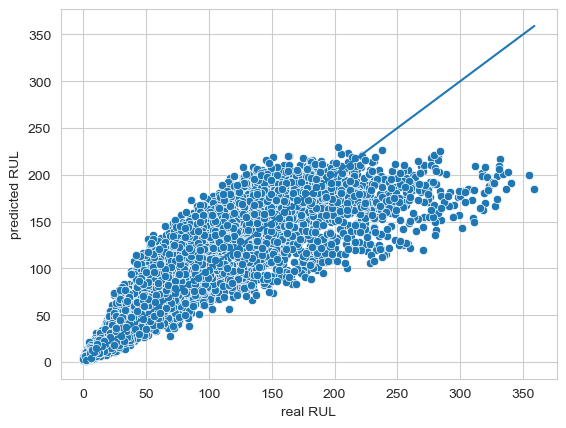

In [72]:
accuracy_plot(test_x_d, test_y_d, pred_rfr_y_d)

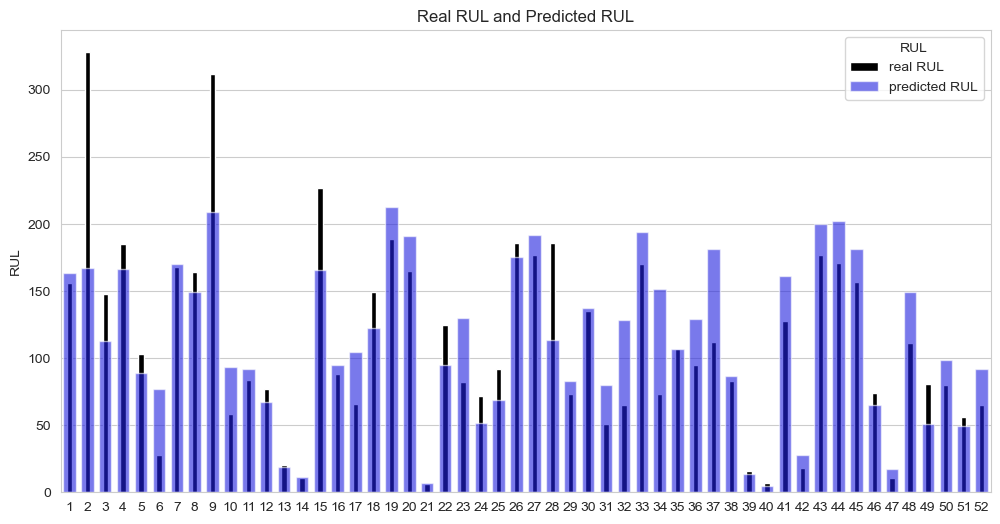

In [73]:
real_predicted_plot(test_y_d[::100],pred_rfr_y_d[::100])

#### Grid search

In [74]:
"""from sklearn.model_selection import RandomizedSearchCV

grid = {'n_estimators':[10,100,200,500],
       'max_depth':[None,5,10,20],
       'max_features':['sqrt'],
       'min_samples_leaf':[1,2,4]}

rfr=RandomForestRegressor(n_jobs = 1)

rs_rfr = RandomizedSearchCV(estimator=rfr,
                                    param_distributions=grid,
                                    n_iter=10,
                                    cv=5,
                                    verbose=2)
rs_rfr.fit(train_x_d, train_y_d)

rs_rfr.best_params_"""

"from sklearn.model_selection import RandomizedSearchCV\n\ngrid = {'n_estimators':[10,100,200,500],\n       'max_depth':[None,5,10,20],\n       'max_features':['sqrt'],\n       'min_samples_leaf':[1,2,4]}\n\nrfr=RandomForestRegressor(n_jobs = 1)\n\nrs_rfr = RandomizedSearchCV(estimator=rfr,\n                                    param_distributions=grid,\n                                    n_iter=10,\n                                    cv=5,\n                                    verbose=2)\nrs_rfr.fit(train_x_d, train_y_d)\n\nrs_rfr.best_params_"

#  Preparing validation data

In [75]:
x_valid.head()

,Engine,Cycle,Setting 1,Setting 2,Setting 3,(Fan Inlet Temperature) (◦R),(LPC Outlet Temperature) (◦R),(HPC Outlet Temperature) (◦R),(LPT Outlet Temperature) (◦R),(Fan Inlet Pressure) (psia),...,(Ratio of Fuel Flow to Ps30) (pps/psia),(Corrected Fan Speed) (rpm),(Corrected Core Speed) (rpm),(Bypass Ratio),(Burner Fuel-Air Ratio),(Bleed Enthalpy),(Demanded Fan Speed) (rpm),(Demanded Corrected Fan Speed) (rpm),(HPT Coolant Bleed) (lbm/s),(Low-Pressure Turbines Cool Air Flow) (lbm/s)
0,1,1,0.0023,0.0003,100.0,518.67,643.02,1585.29,1398.21,14.62,...,521.72,2388.03,8125.55,8.4052,0.03,392,2388,100.0,38.86,23.3735
1,1,2,-0.0027,-0.0003,100.0,518.67,641.71,1588.45,1395.42,14.62,...,522.16,2388.06,8139.62,8.3803,0.03,393,2388,100.0,39.02,23.3916
2,1,3,0.0003,0.0001,100.0,518.67,642.46,1586.94,1401.34,14.62,...,521.97,2388.03,8130.10,8.4441,0.03,393,2388,100.0,39.08,23.4166
3,1,4,0.0042,0.0000,100.0,518.67,642.44,1584.12,1406.42,14.62,...,521.38,2388.05,8132.90,8.3917,0.03,391,2388,100.0,39.00,23.3737
4,1,5,0.0014,0.0000,100.0,518.67,642.51,1587.19,1401.92,14.62,...,522.15,2388.03,8129.54,8.4031,0.03,390,2388,100.0,38.99,23.4130


In [76]:
current_cycle = x_valid.groupby(['Engine']).agg({'Cycle':'max'})

In [77]:
x_valid=x_valid.merge(current_cycle,on='Engine',how='left')

In [78]:
x_valid_current=x_valid[x_valid['Cycle_x']==x_valid['Cycle_y']]

In [79]:
x_valid_current.drop(constant_columns, axis=1, inplace=True)
x_valid_current.drop(high_corr_columns,axis=1, inplace=True)
x_valid_current.drop(low_corr_columns, axis=1, inplace=True)

x_valid_current.drop('Cycle_y', inplace=True, axis=1)

C:\Users\1xara\AppData\Local\Temp\ipykernel_6840\2031784158.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  x_valid_current.drop(constant_columns, axis=1, inplace=True)
C:\Users\1xara\AppData\Local\Temp\ipykernel_6840\2031784158.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  x_valid_current.drop(high_corr_columns,axis=1, inplace=True)
C:\Users\1xara\AppData\Local\Temp\ipykernel_6840\2031784158.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

In [80]:
x_valid_current = x_valid_current.reset_index(drop=True)

In [81]:
#x_valid_current.head()

In [82]:
rename_to_feature(x_valid_current)

In [83]:
x_valid_current.head()

,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,feature_8,feature_9,feature_10,feature_11,feature_12,feature_13,feature_14
0,31,642.58,1581.22,1398.91,554.42,2388.08,9056.40,47.23,521.79,2388.06,8.4024,393,38.81,23.3552
1,49,642.55,1586.59,1410.83,553.52,2388.10,9044.77,47.67,521.74,2388.09,8.4505,391,38.81,23.2618
2,126,642.88,1589.75,1418.89,552.59,2388.16,9049.26,47.88,520.83,2388.14,8.4119,395,38.93,23.2740
3,106,642.78,1594.53,1406.88,552.64,2388.13,9051.30,47.65,521.88,2388.11,8.4634,395,38.58,23.2581
4,98,642.27,1589.94,1419.36,553.29,2388.10,9053.99,47.46,521.00,2388.15,8.4362,394,38.75,23.4117


In [84]:
x_valid.drop('Cycle_y', inplace=True, axis=1)

In [85]:
rename_to_feature(x_valid)

In [86]:
x_valid.head()

,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,feature_8,feature_9,feature_10,...,feature_17,feature_18,feature_19,feature_20,feature_21,feature_22,feature_23,feature_24,feature_25,feature_26
0,1,1,0.0023,0.0003,100.0,518.67,643.02,1585.29,1398.21,14.62,...,521.72,2388.03,8125.55,8.4052,0.03,392,2388,100.0,38.86,23.3735
1,1,2,-0.0027,-0.0003,100.0,518.67,641.71,1588.45,1395.42,14.62,...,522.16,2388.06,8139.62,8.3803,0.03,393,2388,100.0,39.02,23.3916
2,1,3,0.0003,0.0001,100.0,518.67,642.46,1586.94,1401.34,14.62,...,521.97,2388.03,8130.10,8.4441,0.03,393,2388,100.0,39.08,23.4166
3,1,4,0.0042,0.0000,100.0,518.67,642.44,1584.12,1406.42,14.62,...,521.38,2388.05,8132.90,8.3917,0.03,391,2388,100.0,39.00,23.3737
4,1,5,0.0014,0.0000,100.0,518.67,642.51,1587.19,1401.92,14.62,...,522.15,2388.03,8129.54,8.4031,0.03,390,2388,100.0,38.99,23.4130


# Predictions on validation data

#### Random forest

In [87]:
pred_valid_rfr=rfr_d.predict(x_valid_current)

In [88]:
results(y_valid, pred_valid_rfr)

R2 = 0.5930950853833075; Mean Absolute Error = -19.361241947657117; Mean Squared Error = -702.671727142162


{'r2': 0.5930950853833075,
 'mae': -19.361241947657117,
 'mse': -702.671727142162}

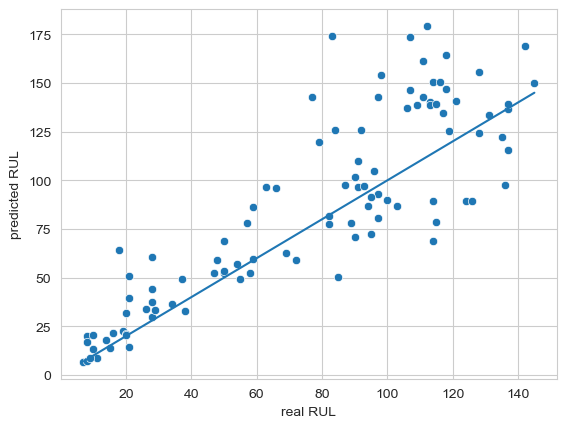

In [89]:
accuracy_plot(x_valid_current, y_valid['RUL'], pred_valid_rfr)

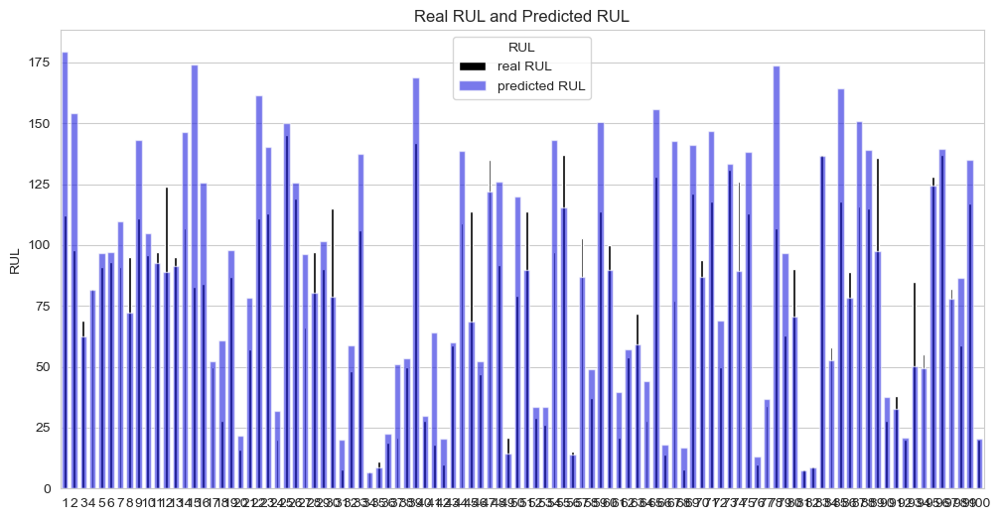

In [90]:
real_predicted_plot( y_valid['RUL'], pred_valid_rfr)

#### linear regression

In [91]:
pred_valid_lr=lr_d.predict(x_valid_current)

In [92]:
results(y_valid, pred_valid_lr)

R2 = 0.43427938439289127; Mean Absolute Error = -26.0015554227728; Mean Squared Error = -976.9257331852014


{'r2': 0.43427938439289127,
 'mae': -26.0015554227728,
 'mse': -976.9257331852014}

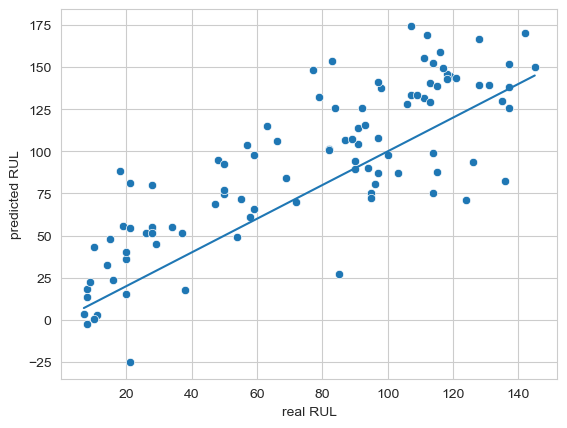

In [93]:
accuracy_plot(x_valid_current, y_valid['RUL'], pred_valid_lr)

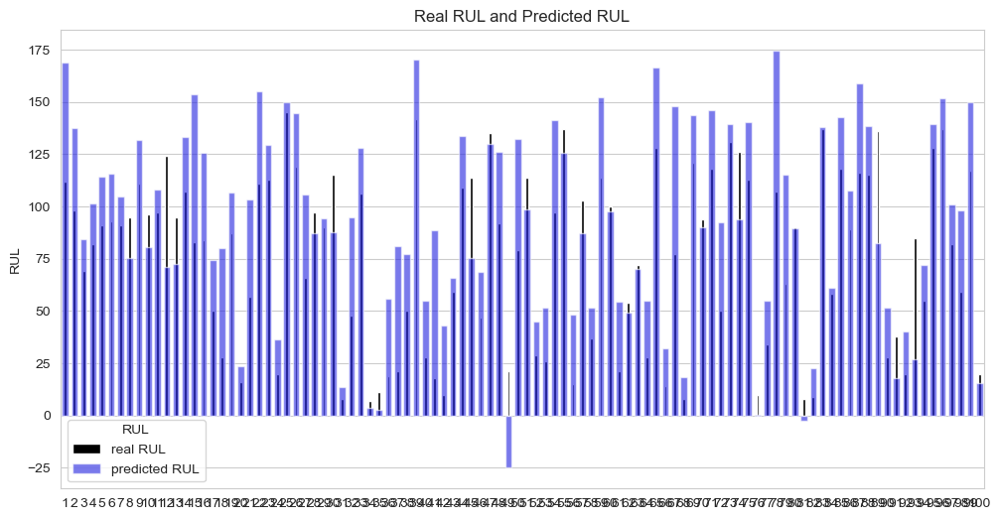

In [94]:
real_predicted_plot( y_valid['RUL'], pred_valid_lr)